In [1]:
import numpy as np
import pandas as pd
from pathlib import Path

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
path_results = Path("../data/results/")

In [3]:
all_oof = dict(
    lightgbm = pd.read_csv(path_results / "oof_lightgbm.csv"),
    xgboost = pd.read_csv(path_results / "oof_xgboost.csv"),
    catboost = pd.read_csv(path_results / "oof_catboost.csv"),
    mlp = pd.read_csv(path_results / "oof_mlp.csv"),
)

combined_df = pd.DataFrame({'utility_agent1_true': all_oof['lightgbm']['utility_agent1_true']})
for model, df in all_oof.items():
    combined_df[f'utility_agent1_pred_{model}'] = df['utility_agent1_pred']

combined_df.head()

,utility_agent1_true,utility_agent1_pred_lightgbm,utility_agent1_pred_xgboost,utility_agent1_pred_catboost,utility_agent1_pred_mlp
0,-0.466667,-0.262848,0.011462,-0.037220,-0.316174
1,-0.333333,-0.044462,-0.354841,-0.188035,-0.442619
2,-0.066667,0.146970,0.245672,0.118142,-0.279256
3,-0.333333,0.026139,-0.005258,-0.006440,-0.516010
4,-0.333333,0.001091,-0.063074,-0.077434,-0.312319


In [4]:
# Create a long-form DataFrame for plotting
melted_df = combined_df.melt(
    value_vars=[
        'utility_agent1_pred_lightgbm', 
        'utility_agent1_pred_xgboost', 
        'utility_agent1_pred_catboost',
        'utility_agent1_pred_mlp',
        'utility_agent1_true'
    ],
    var_name='Model',
    value_name='Utility Agent 1'
)

# Map model names for better labels
model_mapping = {
    'utility_agent1_pred_lightgbm': 'LightGBM',
    'utility_agent1_pred_xgboost': 'XGBoost',
    'utility_agent1_pred_catboost': 'CatBoost',
    'utility_agent1_pred_mlp': 'MLP',
    'utility_agent1_true': 'True Values'
}
melted_df['Model'] = melted_df['Model'].map(model_mapping)

# Create a distribution plot for each model's predictions using Plotly Express
fig = px.histogram(
    melted_df, 
    x='Utility Agent 1', 
    color='Model',
    histnorm='percent',
    opacity=0.66,
    nbins=100,
    title='Distribution of Predictions for Each Model',
    labels={'Utility Agent 1': 'Utility Agent 1'}
)

fig.update_layout(
    barmode='overlay',
    xaxis_title='Utility Agent 1',
    yaxis_title='Percent',
    legend_title='Model'
)
fig.show()


Correlation matrix between model predictions:
                              utility_agent1_pred_lightgbm  \
utility_agent1_pred_lightgbm                      1.000000   
utility_agent1_pred_xgboost                       0.960192   
utility_agent1_pred_catboost                      0.938504   
utility_agent1_pred_mlp                           0.826637   

                              utility_agent1_pred_xgboost  \
utility_agent1_pred_lightgbm                     0.960192   
utility_agent1_pred_xgboost                      1.000000   
utility_agent1_pred_catboost                     0.932482   
utility_agent1_pred_mlp                          0.821524   

                              utility_agent1_pred_catboost  \
utility_agent1_pred_lightgbm                      0.938504   
utility_agent1_pred_xgboost                       0.932482   
utility_agent1_pred_catboost                      1.000000   
utility_agent1_pred_mlp                           0.842226   

                          

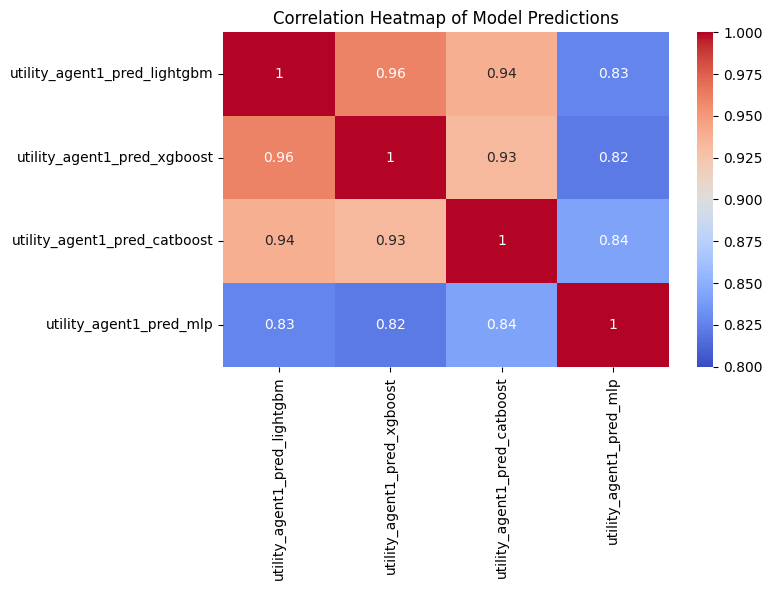


Correlation between true values and predictions:
utility_agent1_pred_lightgbm    0.704427
utility_agent1_pred_xgboost     0.688636
utility_agent1_pred_catboost    0.691660
utility_agent1_pred_mlp         0.643293
Name: utility_agent1_true, dtype: float64


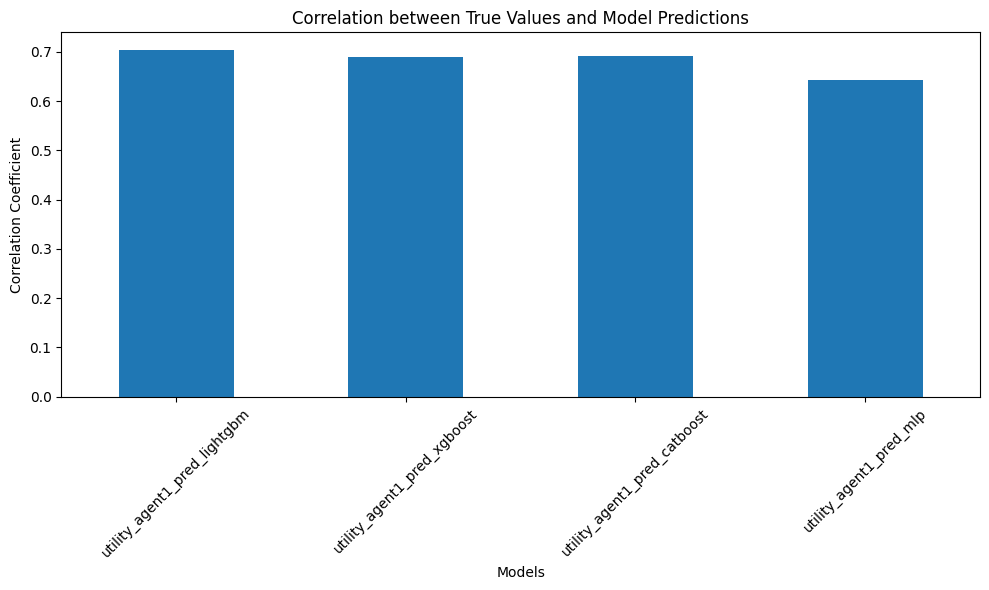

In [5]:
# Calculate correlation between model predictions
correlation_matrix = combined_df.filter(like='pred').corr()

# Display the correlation matrix
print("Correlation matrix between model predictions:")
print(correlation_matrix)

plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=0.8, vmax=1)
plt.title('Correlation Heatmap of Model Predictions')
plt.tight_layout()
plt.show()

# Calculate correlation between true values and predictions
true_vs_pred_corr = combined_df.corr()['utility_agent1_true'].filter(like='pred')

print("\nCorrelation between true values and predictions:")
print(true_vs_pred_corr)

# Visualize the correlation between true values and predictions
plt.figure(figsize=(10, 6))
true_vs_pred_corr.plot(kind='bar')
plt.title('Correlation between True Values and Model Predictions')
plt.xlabel('Models')
plt.ylabel('Correlation Coefficient')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

***